In [98]:
#Importing The Necessary Libraries
import pandas as pd
import numpy as np
import re
from gensim.models import Word2Vec
from tensorflow import keras
from keras import layers
from keras.layers import Dense, Input, Flatten
import nltk
from nltk.tokenize import word_tokenize
import html
from gensim.models import KeyedVectors  
from sklearn.model_selection import train_test_split
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Embedding, Conv1D, MaxPooling1D, Flatten, Dense, Dropout,Bidirectional, LSTM
from keras import regularizers
from keras import optimizers
from keras.callbacks import LearningRateScheduler
import matplotlib.pyplot as plt
from wordcloud import WordCloud

In [99]:
#Reading the dataset
data=pd.read_csv(r'C:\Users\ADHISH S\Desktop\NLP_TEST\train.csv')
test_data=pd.read_csv(r'C:\Users\ADHISH S\Desktop\NLP_TEST\test.csv')

In [100]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 770 entries, 0 to 769
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Tweets  599 non-null    object
 1   label   599 non-null    object
dtypes: object(2)
memory usage: 12.2+ KB


In [101]:
#Cleaning Text

special_characters_to_remove = r'[!‘"#$%&\'()*+,-./:;<=>?@[\]^_`{|}~\\]'


def clean_tweet(x):
    x = x.replace('#39;', "'").replace('amp;', '&').replace('#146;', "'").replace(
        'nbsp;', ' ').replace('#36;', '$').replace('\\n', "\n").replace('quot;', "'").replace(
        '<br />', "\n").replace('\\"', '"').replace('<unk>', 'u_n').replace(' @.@ ', '.').replace(
        ' @-@ ', '-').replace('\\', ' \\ ').replace('\u200d', '').replace('\xa0', ' ').replace(
        '\u200c', '').replace('“', ' ').replace('”', ' ').replace('"', ' ').replace('\u200b', '')
    x = re.sub(r'\([^)]*\)', '', x)  # Remove text within parentheses
    x = re.sub('<[^<]+?>', '', x)  # Remove HTML tags
    x = re.sub(r'\d+(\.\d+)?', 'NUM ', x)  # Replace numbers with 'NUM'
    x = re.sub(special_characters_to_remove, ' ', x)  # Remove specified special characters
    x = re.sub(r'\s+', ' ', x)  # Remove extra spaces
    return x.strip()  # Strip leading/trailing spaces

In [102]:
data.columns

Index(['Tweets', 'label'], dtype='object')

In [103]:
#Checking For Null Values
data.isnull().sum()

Tweets    171
label     171
dtype: int64

In [104]:
#checking for null values
test_data.isnull().sum()

Tweets    0
label     0
dtype: int64

In [105]:
#Dropping all the null values
data=data.dropna()

In [106]:
#Null values is handled
data.isnull().sum()

Tweets    0
label     0
dtype: int64

In [107]:
#Checking For duplicate values
data.duplicated().sum()

0

In [108]:
data['Tweets']

0      Asked #ChatGPT about what it thinks are the pr...
1      #ChatGPT tornado has already traveled around t...
2      This is a great explanation of why #EVs are mo...
3      ‘if you need to write a box-ticking social med...
4      Just saw an AI tool making my coffee for me. \...
                             ...                        
594    4. GPT’s AI capabilities are also more accessi...
595    3. KeyboardX also provides a more secure envir...
596    2. KeyboardX allows users to quickly and easil...
597    I asked ChatGPT why the app I’m working on, Ke...
598    There's been a lot of talk about AI engines an...
Name: Tweets, Length: 599, dtype: object

In [109]:
#Applying the cleaning function
data['Tweets']=data['Tweets'].apply(clean_tweet)


In [110]:
data['Tweets']

0      Asked ChatGPT about what it thinks are the pro...
1      ChatGPT tornado has already traveled around th...
2      This is a great explanation of why EVs are mor...
3      if you need to write a box ticking social medi...
4      Just saw an AI tool making my coffee for me Ch...
                             ...                        
594    NUM GPT’s AI capabilities are also more access...
595    NUM KeyboardX also provides a more secure envi...
596    NUM KeyboardX allows users to quickly and easi...
597    I asked ChatGPT why the app I’m working on Key...
598    There s been a lot of talk about AI engines an...
Name: Tweets, Length: 599, dtype: object

In [111]:
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to C:\Users\ADHISH
[nltk_data]     S\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [112]:
#tweet Tockenisation
def tokenize_tweets(data):
    tokenized_tweets = []
    for tweet in data["Tweets"]:
        # Preprocess the tweet
        cleaned_tweet = clean_tweet(tweet)
        
        # Tokenize the cleaned tweet into words
        words = word_tokenize(cleaned_tweet, language="english")
        tokenized_tweets.append(words)
    return tokenized_tweets

In [113]:
train_tockenised=tokenize_tweets(data)
test_data_tockenised=tokenize_tweets(test_data)


In [114]:
data

,Tweets,label
0,Asked ChatGPT about what it thinks are the pro...,Positive
1,ChatGPT tornado has already traveled around th...,Neutral
2,This is a great explanation of why EVs are mor...,Positive
3,if you need to write a box ticking social medi...,Positive
4,Just saw an AI tool making my coffee for me Ch...,Positive
...,...,...
594,NUM GPT’s AI capabilities are also more access...,Positive
595,NUM KeyboardX also provides a more secure envi...,Positive
596,NUM KeyboardX allows users to quickly and easi...,Positive
597,I asked ChatGPT why the app I’m working on Key...,Positive


In [115]:
print(train_tockenised)

[['Asked', 'ChatGPT', 'about', 'what', 'it', 'thinks', 'are', 'the', 'problems', 'associated', 'with', 'urbanisation', 'in', 'India', 'the', 'solutions', 'to', 'be', 'adopted', 'to', 'boost', 'public', 'transport', 'use', 'in', 'our', 'cities', 'Interesting', 'set', 'of', 'responses', 'EconTwitter', 'UrbanEconomics', 'sselvan', 'https', 't', 'co', 'yTyDNUM', 'ypxDh'], ['ChatGPT', 'tornado', 'has', 'already', 'traveled', 'around', 'the', 'world', 'several', 'times', 'and', 'it', '’', 's', 'not', 'over', 'We', 'are', 'just', 'starting', 'to', 'understand', 'how', 'much', 'Generative', 'AI', 'could', 'change', 'the', 'way', 'we', 'work', 'scared', 'Yes', 'excited', 'Yes', 'critical', 'sense', 'More', 'than', 'ever', 'AI', '👉', 'linkedin', 'com', 'pulse', 'new', 'ways…'], ['This', 'is', 'a', 'great', 'explanation', 'of', 'why', 'EVs', 'are', 'more', 'efficient', 'with', 'energy', 'from', 'ChatGPT', 'than', 'the', 'combustion', 'engine', '…', 'it', '’', 's', 'even', 'impressed', 'YingShirle

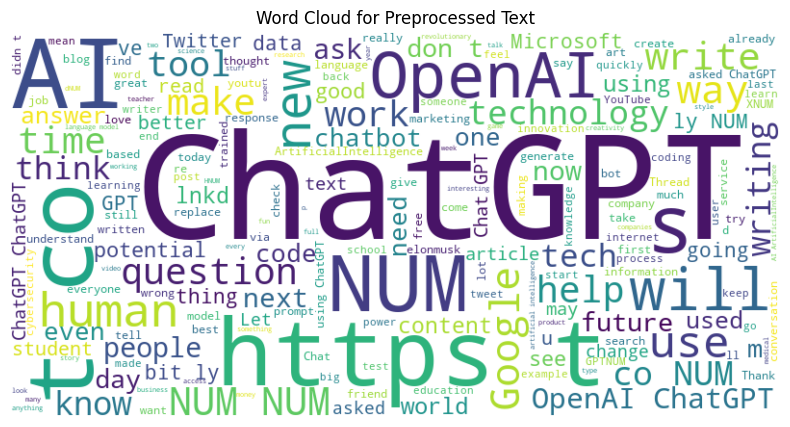

In [116]:
#printing the world_cloud
preprocessed_words = ' '.join(data['Tweets'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(preprocessed_words)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Preprocessed Text')
plt.show()


In [117]:
# Extracting word vectors using Word2Vec
def extract_word_vectors(tokenized_data, vector_size=300, window=5, min_count=1, sg=0):
    model = Word2Vec(sentences=tokenized_data, vector_size=vector_size, window=window, min_count=min_count, sg=sg)
    word_vectors = {word: model.wv[word] for word in model.wv.index_to_key}
    return word_vectors

In [118]:
train_vectors=extract_word_vectors(train_tockenised)
test_vectors=extract_word_vectors(test_data_tockenised)

In [119]:
print(train_vectors)

{'ChatGPT': array([ 6.26382371e-03,  1.34714648e-01, -4.46577556e-02,  6.17271438e-02,
       -8.48251209e-03, -1.34205818e-01,  9.92120057e-02,  2.98797995e-01,
        2.24401169e-02, -9.41007361e-02,  4.10833769e-02, -1.22332565e-01,
       -9.94139537e-03,  6.32368922e-02, -1.33826137e-01, -1.13331810e-01,
        1.01089053e-01, -4.30385657e-02,  4.99980561e-02, -6.76978305e-02,
       -4.62816209e-02, -5.57452142e-02,  1.08274698e-01,  6.08176775e-02,
        9.51825753e-02, -2.77169817e-03, -1.53291047e-01,  7.66174868e-03,
       -8.59787762e-02, -1.49039626e-01,  1.48961460e-02, -4.66943234e-02,
        5.29447012e-02, -1.09636309e-02, -4.04328518e-02,  5.55214062e-02,
        8.37352052e-02, -1.61755487e-01, -2.88339201e-02, -2.28597075e-02,
       -8.05881396e-02, -2.50132056e-04, -2.80060037e-03, -1.34199232e-01,
        5.07501625e-02,  1.11637056e-01,  1.00926235e-02,  6.25605956e-02,
       -3.12572420e-02,  1.01135477e-01,  3.43465470e-02,  3.78326364e-02,
       -8.303

In [120]:
train_labels=data['label']
test_labels=test_data['label']

In [121]:
# Encoding labels using LabelEncoder
label_encoder = LabelEncoder()
train_labels_encoded = label_encoder.fit_transform(train_labels)
test_labels_encoded = label_encoder.transform(test_labels)


In [122]:
from keras.preprocessing.text import Tokenizer

# Creating a tokenizer and fitting it on the training data
tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_tockenised)

# Converting the tokenized text to sequences of integers
X_train = tokenizer.texts_to_sequences(train_tockenised)
X_test = tokenizer.texts_to_sequences(test_data_tockenised)

# Pad sequences to have the same length
X_train = pad_sequences(X_train, maxlen=100)
X_test = pad_sequences(X_test, maxlen=100)

BUILDING THE MODEL

In [123]:
# Defining lr_schedule function
def lr_schedule(epoch):
    lr = 1e-3
    if epoch > 5:
        lr *= 0.1
    return lr

EMBEDDING_DIM=300
MAX_SEQUENCE_LENGTH=100
num_classes=3

In [124]:

# Creating a custom LearningRateScheduler callback
class CustomLearningRateScheduler(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        if not hasattr(self.model.optimizer, 'lr'):
            raise ValueError('Optimizer must have a "lr" attribute.')
        # Get the current learning rate
        lr = float(tf.keras.backend.get_value(self.model.optimizer.lr))
        # Call the lr_schedule function to get the new learning rate
        new_lr = lr_schedule(epoch)
        # Set the new learning rate
        tf.keras.backend.set_value(self.model.optimizer.lr, new_lr)
        print(f'\nEpoch {epoch+1} Learning Rate: {new_lr}')

# Creating the LSTM model
model = Sequential()

vocab_size = len(tokenizer.word_index) + 1
embedding_matrix = np.zeros((vocab_size, EMBEDDING_DIM))

for word, i in tokenizer.word_index.items():
    if word in train_vectors:
        embedding_matrix[i] = train_vectors[word]

embedding_layer = Embedding(input_dim=vocab_size, output_dim=EMBEDDING_DIM, input_length=MAX_SEQUENCE_LENGTH,
                            weights=[embedding_matrix], trainable=False)
model.add(embedding_layer)

model.add(Bidirectional(LSTM(128, return_sequences=True)))
model.add(Bidirectional(LSTM(64)))
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))


Compiling

In [125]:
# Initializing the learning rate using lr_schedule(0)
optimizer = Adam(learning_rate=lr_schedule(0))
model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [126]:
# Training the model
batch_size = 32
epochs = 50

# Creating an instance of the custom learning rate scheduler callback
lr_scheduler = CustomLearningRateScheduler()

history = model.fit(X_train, train_labels_encoded,
                    batch_size=batch_size,
                    epochs=epochs,
                    verbose=2,
                    callbacks=[lr_scheduler])


Epoch 1 Learning Rate: 0.001
Epoch 1/50


19/19 - 5s - loss: 0.9681 - accuracy: 0.6027 - 5s/epoch - 255ms/step

Epoch 2 Learning Rate: 0.001
Epoch 2/50
19/19 - 1s - loss: 0.9192 - accuracy: 0.6294 - 533ms/epoch - 28ms/step

Epoch 3 Learning Rate: 0.001
Epoch 3/50
19/19 - 1s - loss: 0.9255 - accuracy: 0.6294 - 514ms/epoch - 27ms/step

Epoch 4 Learning Rate: 0.001
Epoch 4/50
19/19 - 1s - loss: 0.9237 - accuracy: 0.6311 - 500ms/epoch - 26ms/step

Epoch 5 Learning Rate: 0.001
Epoch 5/50
19/19 - 1s - loss: 0.9126 - accuracy: 0.6294 - 512ms/epoch - 27ms/step

Epoch 6 Learning Rate: 0.001
Epoch 6/50
19/19 - 1s - loss: 0.9245 - accuracy: 0.6327 - 507ms/epoch - 27ms/step

Epoch 7 Learning Rate: 0.0001
Epoch 7/50
19/19 - 1s - loss: 0.9109 - accuracy: 0.6311 - 521ms/epoch - 27ms/step

Epoch 8 Learning Rate: 0.0001
Epoch 8/50
19/19 - 1s - loss: 0.9011 - accuracy: 0.6311 - 521ms/epoch - 27ms/step

Epoch 9 Learning Rate: 0.0001
Epoch 9/50
19/19 - 1s - loss: 0.9055 - accuracy: 0.6294 - 507ms/epoch - 27ms/step

Epoch 10 Learning Rate: 0.0001


In [127]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 100, 300)          1249500   
                                                                 
 bidirectional_6 (Bidirectio  (None, 100, 256)         439296    
 nal)                                                            
                                                                 
 bidirectional_7 (Bidirectio  (None, 128)              164352    
 nal)                                                            
                                                                 
 dense_6 (Dense)             (None, 64)                8256      
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_7 (Dense)             (None, 3)                

Test Accuracy

In [128]:
# Evaluating the model
loss, accuracy = model.evaluate(X_test, test_labels_encoded)
print(f'\nTest Accuracy (LSTM): {accuracy}')


6/6 [==============================] - 2s 13ms/step - loss: 0.8559 - accuracy: 0.6706

Test Accuracy (LSTM): 0.6705882549285889


Accuracy is 67%